## NeurIPS Generate Spins

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

/ext3/miniconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
2025-04-28 18:27:25.126546: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-28 18:27:26.793332: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-04-28 18:27:28.638297: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
  import numpy.matlib as npm

  au

In [10]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

#### Check job specs

In [11]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 2.0%
RAM Usage: 10.0%
Available RAM: 339.2G
Total RAM: 376.8G
52.4G


In [12]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


None
Available GPUs: 0


### Data viz

In [13]:
from data.data_load import load_transcriptome, load_connectome, load_coords, load_network_labels
from data.data_viz import plot_connectome, plot_transcriptome
from data.data_utils import expand_X_symmetric, expand_Y_symmetric

In [14]:
X = load_transcriptome(parcellation='S400', hemisphere='both', omit_subcortical=False, sort_genes='chromosome', impute_strategy='mirror_interpolate')
Y = load_connectome(parcellation='S400', hemisphere='both', omit_subcortical=False)
coords = load_coords(parcellation='S400', hemisphere='both', omit_subcortical=False)
labels, network_labels = load_network_labels(parcellation='S400', hemisphere='both', omit_subcortical=False)

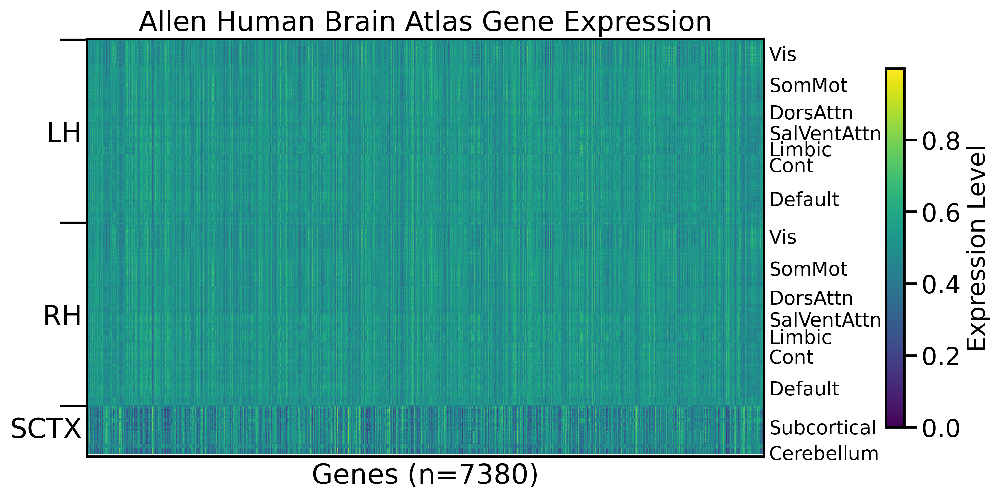

In [15]:
plot_transcriptome(null_model='none', parcellation='S400', hemisphere='both', omit_subcortical=False, gene_list='0.2', sort_genes='chromosome', impute_strategy='mirror_interpolate') #, add_hemisphere_labels=True, add_network_labels=False)

Spinning gene expression
Spin index for seed 42: 9
(10000, 400)
(10000, 56)
(400,)
(56,)


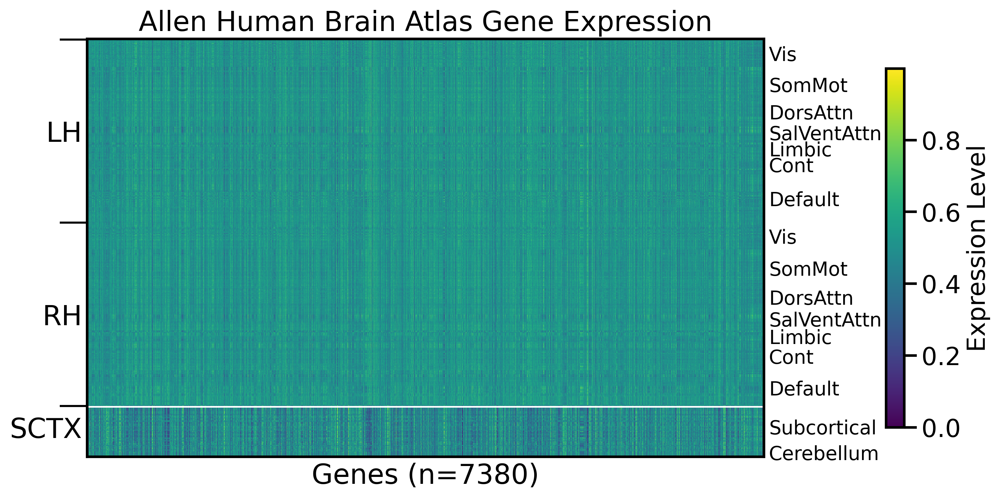

In [22]:
plot_transcriptome(random_seed=42, null_model='spin', parcellation='S400', hemisphere='both', omit_subcortical=False, gene_list='0.2', sort_genes='chromosome', impute_strategy='mirror_interpolate') #, add_hemisphere_labels=True, add_network_labels=False)

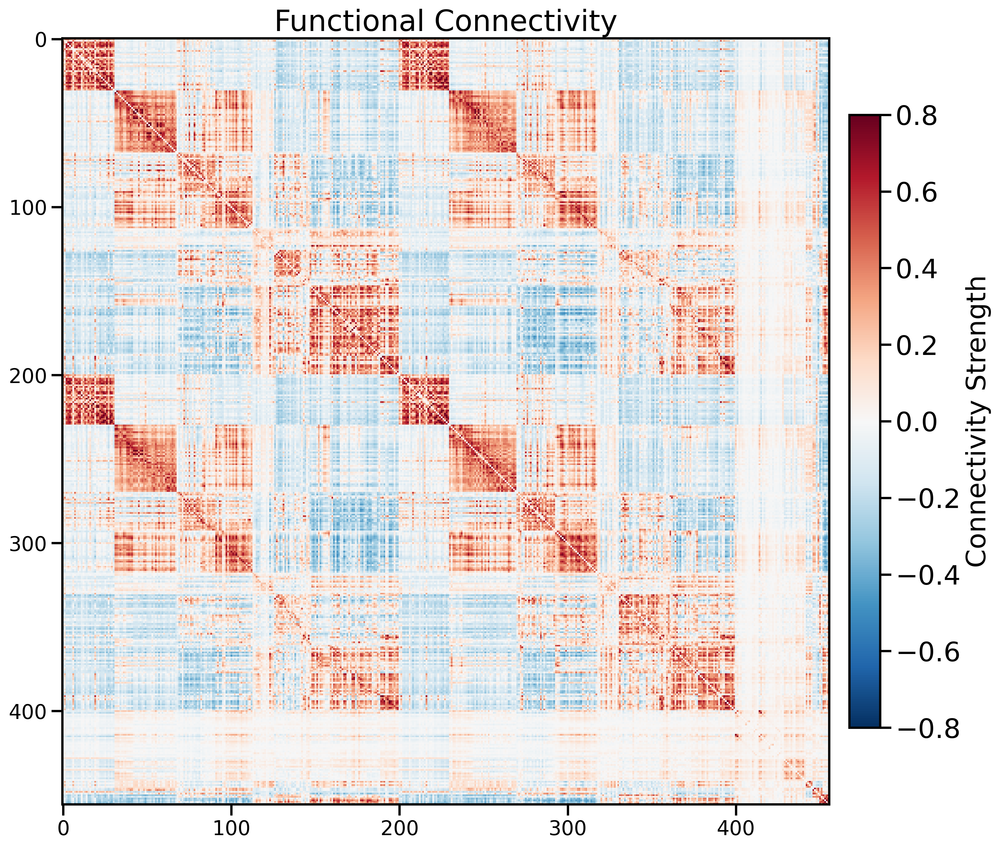

In [11]:
plot_connectome(parcellation='S400', hemisphere='both', measure='FC', omit_subcortical=False, add_network_labels=False)

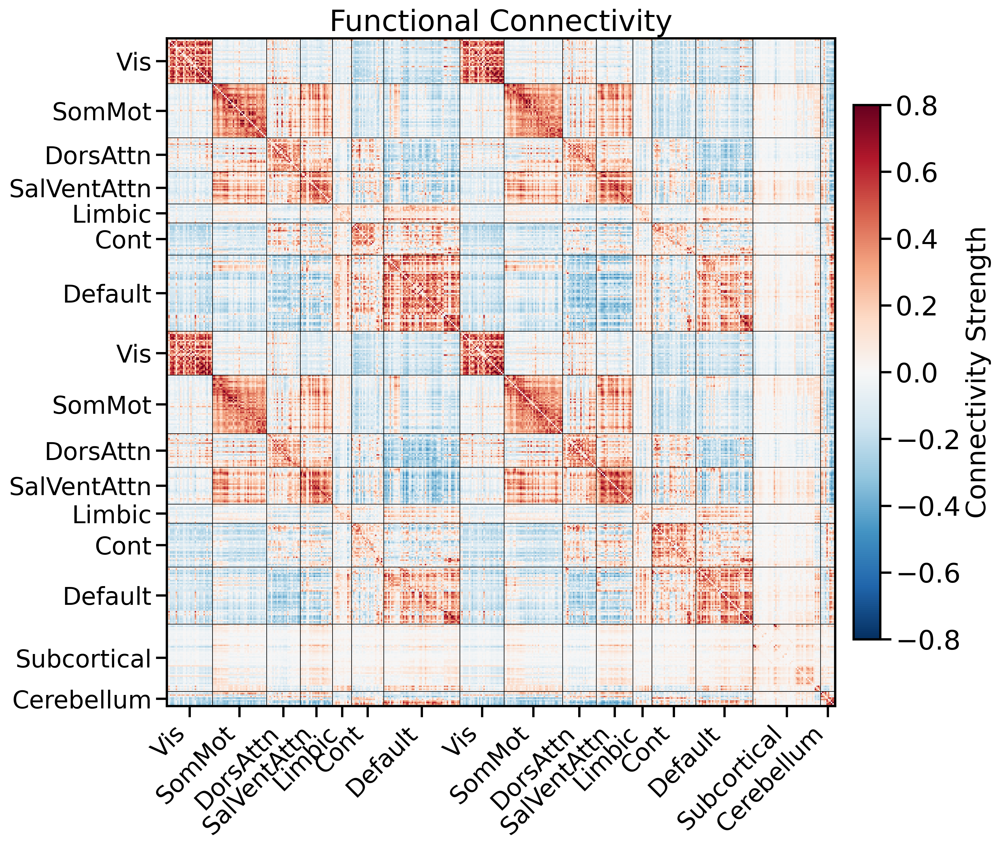

In [12]:
plot_connectome(parcellation='S400', hemisphere='both', measure='FC', omit_subcortical=False, add_network_labels=True)

### Spatial autocorr analysis

In [13]:
from sim.null import *

Number of components for 95% variance PCA: 27


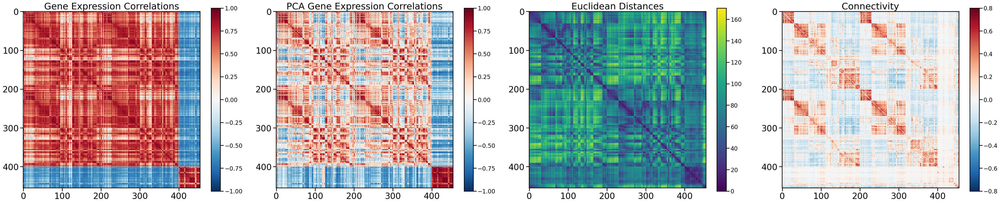

In [14]:
X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix = load_and_plot_data(parcellation='S400', hemisphere='both', omit_subcortical=False, 
                      sort_genes='expression', impute_strategy='mirror_interpolate', null_model='none', fontsize=26)

features, features_cortex, features_subcortex = subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix)

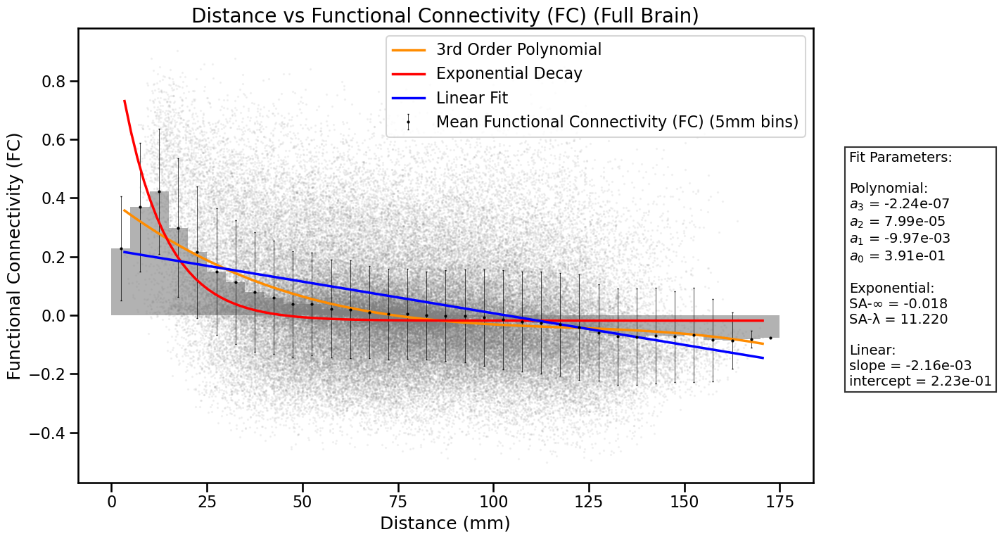

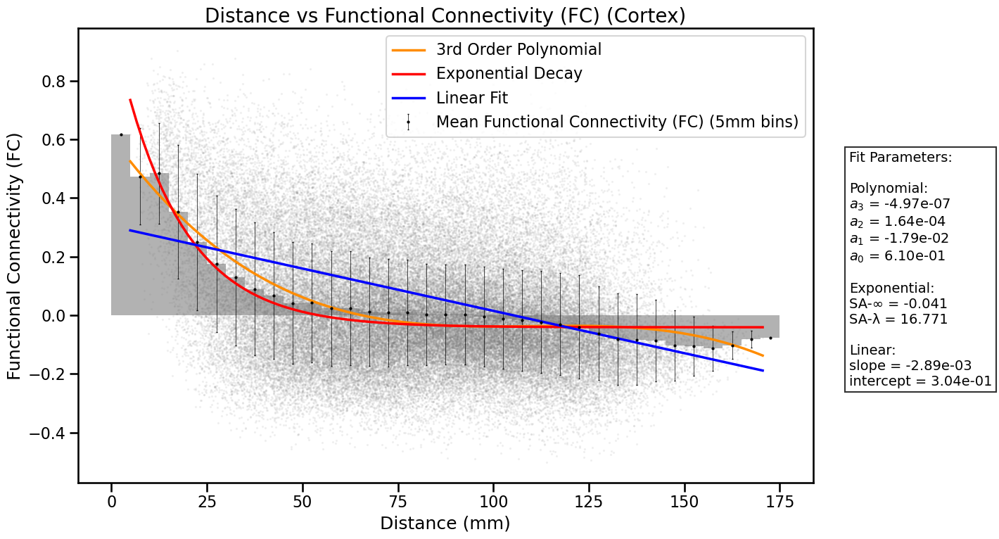

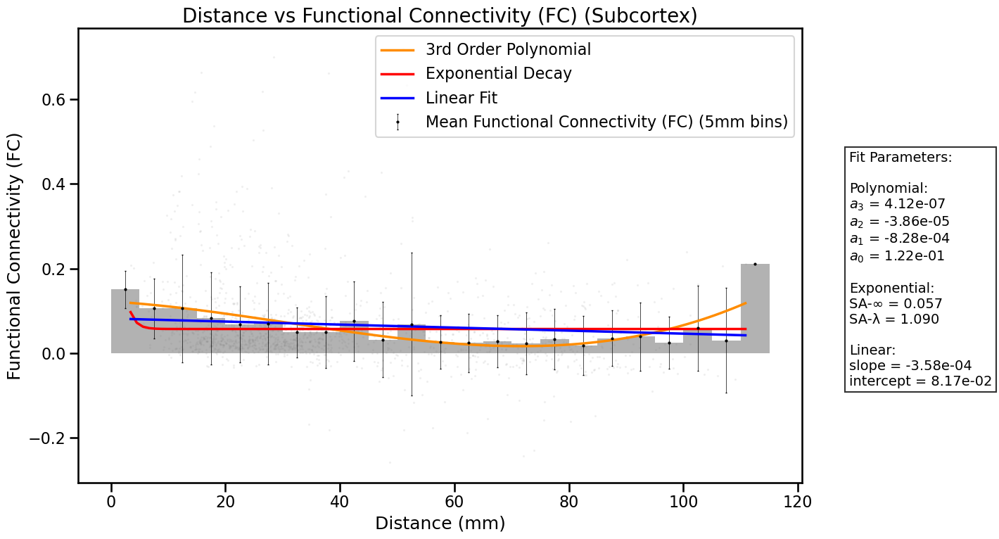

In [14]:
plot_distance_fits(features, 'FC', 5, 'Full Brain')
plot_distance_fits(features_cortex, 'FC', 5, 'Cortex')
plot_distance_fits(features_subcortex, 'FC', 5, 'Subcortex')

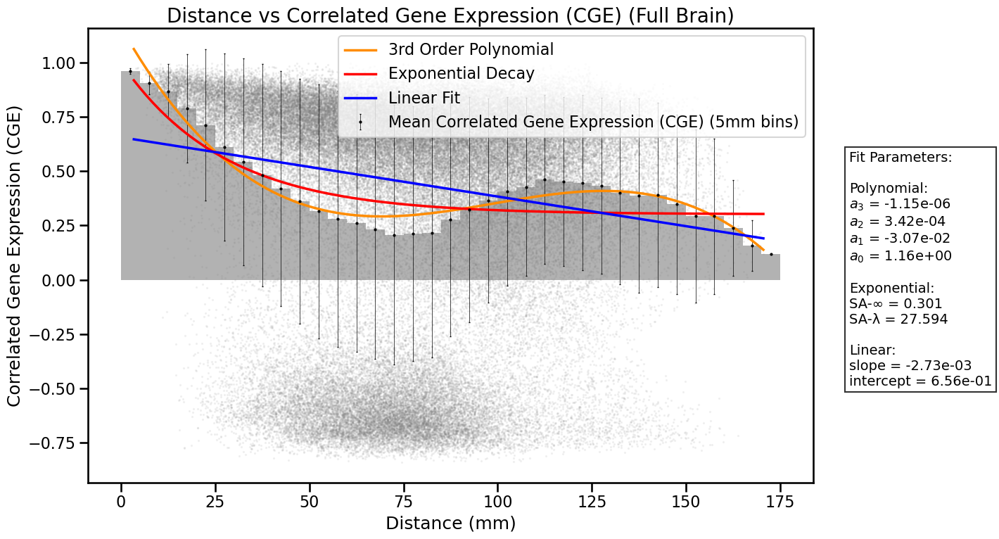

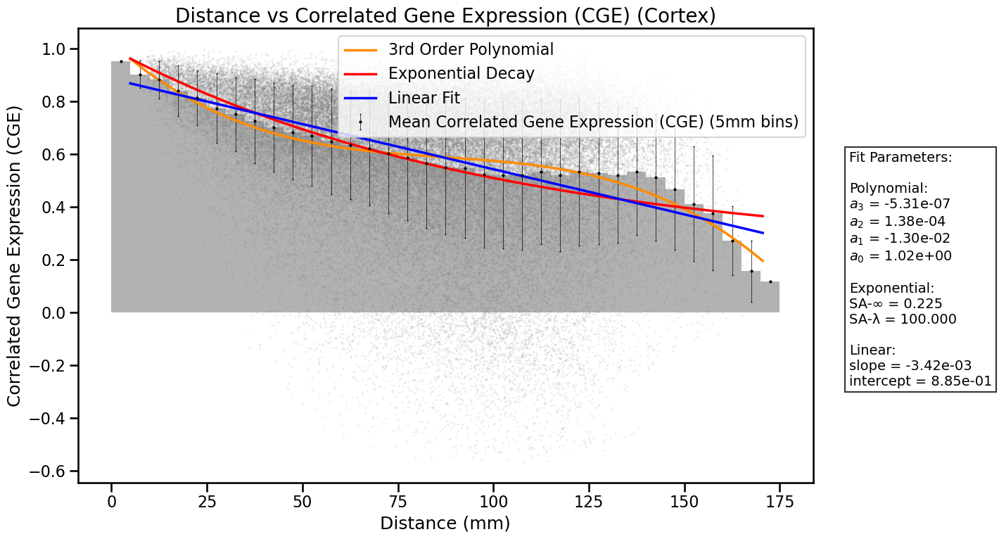

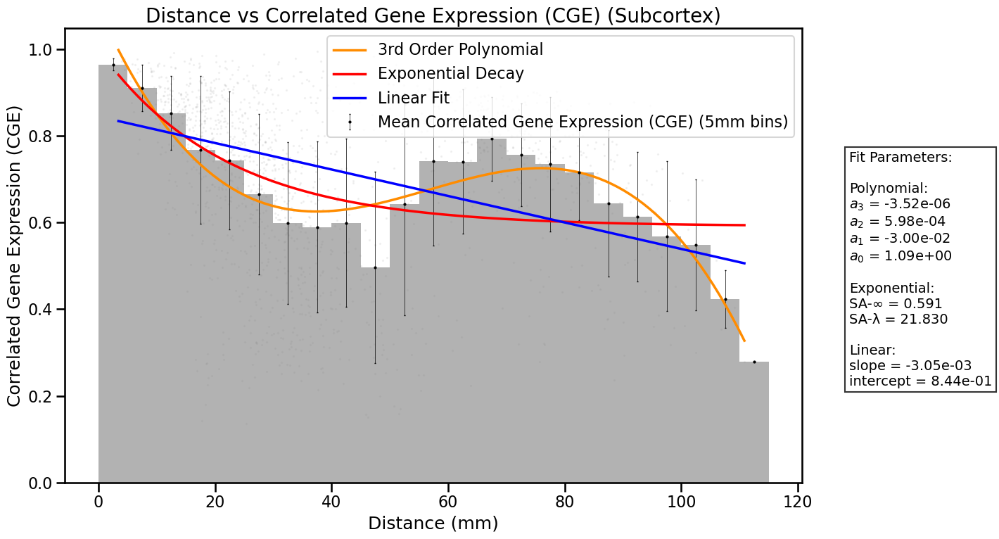

In [17]:
plot_distance_fits(features, 'CGE', 5, 'Full Brain')
plot_distance_fits(features_cortex, 'CGE', 5, 'Cortex')
plot_distance_fits(features_subcortex, 'CGE', 5, 'Subcortex')


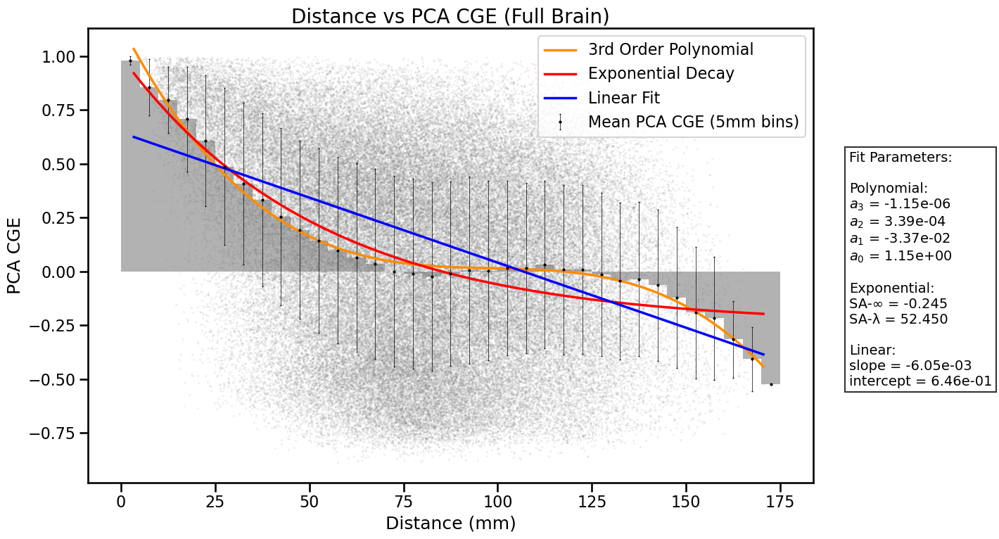

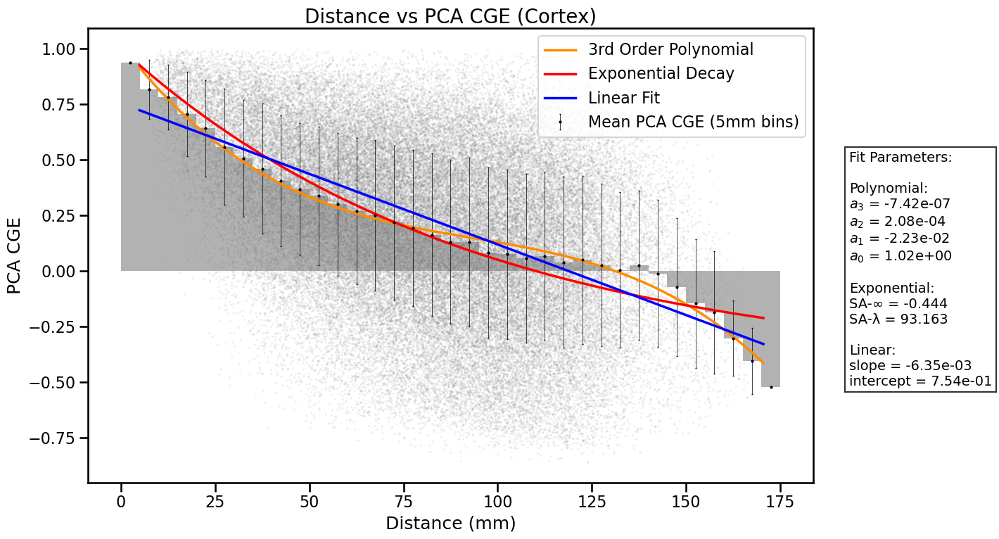

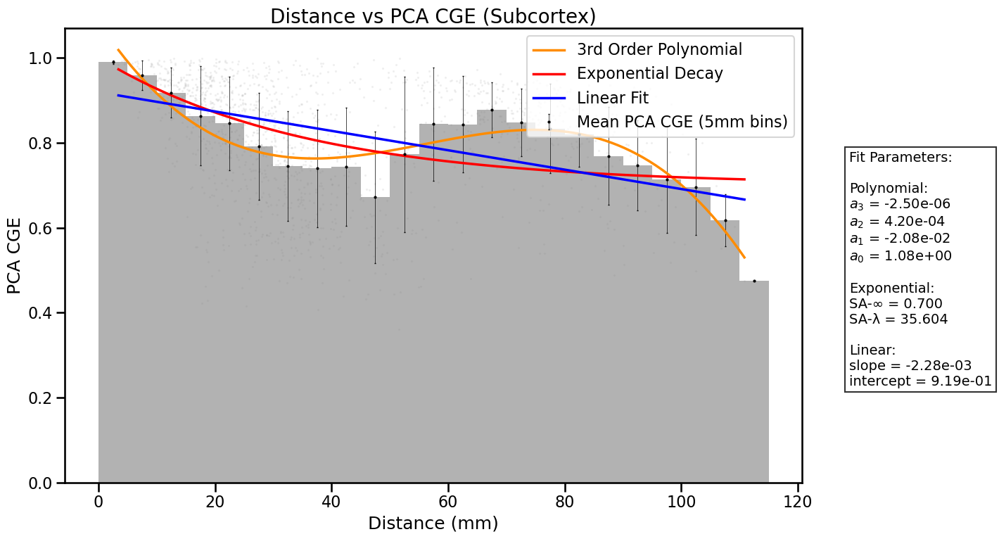

In [15]:
plot_distance_fits(features, 'PCA_CGE', 5, 'Full Brain')
plot_distance_fits(features_cortex, 'PCA_CGE', 5, 'Cortex')
plot_distance_fits(features_subcortex, 'PCA_CGE', 5, 'Subcortex')

### Create null spin tests

valid genes ['CRNDE', 'ECEL1', 'CHRNA3', 'RSPO4', 'TTR', 'RGS8', 'CA12', 'GINS3', 'KLHL13', 'S100PBP', 'PARD3B', 'PDE3A', 'SIX3', 'SCIN', 'NHSL1', 'BTN2A2', 'PIRT', 'RAB2B', 'SMIM30', 'DRD2', 'LONRF3', 'CYB5R3', 'SLITRK6', 'ELP4', 'HEYL', 'PKNOX1', 'GPRIN2', 'LHX8', 'MEGF11', 'C10orf105', 'AUTS2', 'PDIA3', 'PDIA3P1', 'CPNE3', 'TMEM255A', 'TMEM215', 'CYP7B1', 'IL13RA2', 'GPR75', 'TEAD1', 'KCNE5', 'PDLIM5', 'STAT1', 'C6orf118', 'CYLD', 'BAG3', 'TTPA', 'PINLYP', 'PCDH15', 'PREX2', 'PLXDC2', 'RASL12', 'DERL1', 'SCN7A', 'ARHGAP36', 'DNAJC12', 'AKIRIN2', 'ACVR1', 'ENKUR', 'NPL', 'FLVCR1', 'SAMD11', 'DNAH9', 'ADIPOR1', 'COL8A2', 'MAP3K1', 'LOC100233156', 'ADARB2-AS1', 'PFKFB3', 'SDC2', 'DAB2', 'CASC2', 'RGS22', 'PHKA1', 'HEY2', 'CENPVL3', 'PTGER3', 'CCDC85C', 'YBX3', 'PRSS35', 'VANGL1', 'PLXNA3', 'GLUD1', 'SSR1', 'MLF1', 'FAM210B', 'SERPINB1', 'WDR1', 'CFLAR', 'SZRD1', 'DAPL1', 'SPATA18', 'STK33', 'CFAP61', 'MAML2', 'DIRC2', 'ZNF516', 'MINK1', 'FAM111A', 'LINC01485', 'SCN9A', 'LINC00886', 'CX

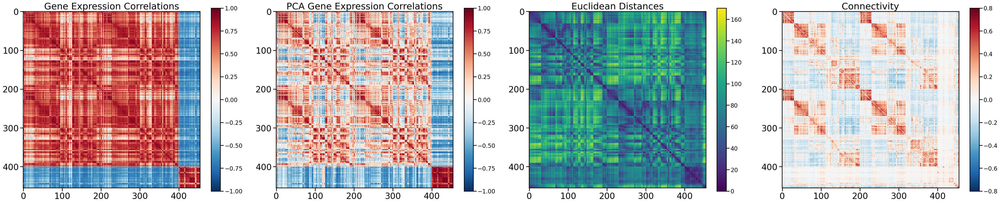

In [16]:
spins_df = generate_null_spins(n_rotations=10, seed=42, bin_size_mm=5, save_csv=False)

In [19]:
spins_df.sort_values('mean_error_rank', ascending=True, inplace=True)
print(spins_df.iloc[:, 4:])
spins_df.head()


     total_cost  mean_error_rank  total_cost_rank  SA_error_rank  \
8  15562.749509         2.333333              2.0            2.0   
2  16259.629432         3.000000              5.0            3.0   
7  10602.778447         3.666667              1.0            4.0   
0  17019.041037         4.333333              8.0            1.0   
3  15885.512724         5.000000              3.0            5.0   
5  17367.524744         6.000000             10.0            6.0   
4  17004.772706         6.333333              7.0            7.0   
9  16753.793741         7.333333              6.0            8.0   
6  16101.034898         8.000000              4.0           10.0   
1  17302.791691         9.000000              9.0            9.0   

   poly_error_rank  standardized_SA_error  standardized_poly_error  \
8              3.0               2.229868                16.665002   
2              1.0               2.993139                12.584043   
7              6.0               3.642935

,cortical_spins,subcortical_spins,cortical_cost,subcortical_cost,total_cost,mean_error_rank,total_cost_rank,SA_error_rank,poly_error_rank,standardized_SA_error,...,SA_lambda_PCA,SA_inf_PCA,poly_a1,poly_a2,poly_a3,poly_a4,poly_a1_PCA,poly_a2_PCA,poly_a3_PCA,poly_a4_PCA
8,"[188, 109, 112, 186, 67, 66, 88, 57, 64, 178, ...","[54, 52, 43, 47, 53, 2, 3, 0, 13, 48, 11, 42, ...",13282.952890,2279.796618,15562.749509,2.333333,2.0,2.0,3.0,2.229868,...,28.863321,-0.041290,0.917226,-0.020471,0.000220,-7.251595e-07,0.855997,-0.023788,0.000226,-7.121803e-07
2,"[165, 166, 124, 167, 114, 125, 133, 119, 113, ...","[54, 55, 32, 46, 48, 50, 3, 29, 5, 31, 30, 34,...",14066.498745,2193.130687,16259.629432,3.000000,5.0,3.0,1.0,2.993139,...,34.530601,-0.104178,0.990390,-0.023210,0.000244,-7.754920e-07,0.969185,-0.029299,0.000301,-1.024482e-06
7,"[12, 15, 4, 21, 10, 17, 19, 14, 199, 146, 190,...","[5, 4, 29, 9, 2, 13, 7, 6, 0, 11, 32, 3, 12, 1...",9737.333676,865.444771,10602.778447,3.666667,1.0,4.0,6.0,3.642935,...,34.193715,-0.067259,0.983020,-0.020343,0.000186,-4.930766e-07,0.923409,-0.021599,0.000158,-3.785851e-07
0,"[34, 35, 33, 102, 101, 99, 140, 152, 100, 174,...","[53, 52, 49, 51, 54, 50, 33, 34, 42, 48, 29, 4...",14676.201766,2342.839271,17019.041037,4.333333,8.0,1.0,4.0,1.942103,...,39.069998,-0.164938,0.892056,-0.020372,0.000229,-7.939946e-07,0.892085,-0.026995,0.000288,-1.034092e-06
3,"[48, 106, 110, 109, 55, 199, 179, 194, 54, 182...","[2, 55, 0, 49, 54, 50, 29, 3, 13, 51, 4, 47, 9...",13520.685713,2364.827011,15885.512724,5.000000,3.0,5.0,7.0,4.956122,...,25.958393,0.007003,0.955965,-0.020002,0.000183,-4.740132e-07,0.908789,-0.023540,0.000193,-4.967189e-07


#### Plot some CGE vs distance decay curves

In [19]:
spins_df = pd.read_csv('./data/enigma/10000_null_spins.csv')

In [20]:
spins_df.dtypes

cortical_spins                  object
subcortical_spins               object
cortical_cost                  float64
subcortical_cost               float64
total_cost                     float64
mean_error_rank                float64
total_cost_rank                float64
SA_error_rank                  float64
poly_error_rank                float64
standardized_SA_error          float64
standardized_poly_error        float64
standardized_SA_PCA_error      float64
standardized_poly_PCA_error    float64
SA_lambda                      float64
SA_inf                         float64
SA_lambda_PCA                  float64
SA_inf_PCA                     float64
poly_a1                        float64
poly_a2                        float64
poly_a3                        float64
poly_a4                        float64
poly_a1_PCA                    float64
poly_a2_PCA                    float64
poly_a3_PCA                    float64
poly_a4_PCA                    float64
dtype: object

In [21]:
# Sort spins_df by relevant metric in ascending order
sort_spins = 'mean_error_rank'
spins_df = spins_df.sort_values(sort_spins, ascending=True)

# Get list of indices to use for each null spin
cortical_spins_list = spins_df['cortical_spins'].apply(ast.literal_eval).values
cortical_spin_indices = np.vstack(cortical_spins_list)
print(cortical_spin_indices.shape)

subcortical_spins_list = spins_df['subcortical_spins'].apply(ast.literal_eval).values
subcortical_spin_indices = np.vstack(subcortical_spins_list)
print(subcortical_spin_indices.shape)

(10000, 400)
(10000, 56)


Revisualize true distribution

Number of components for 95% variance PCA: 27


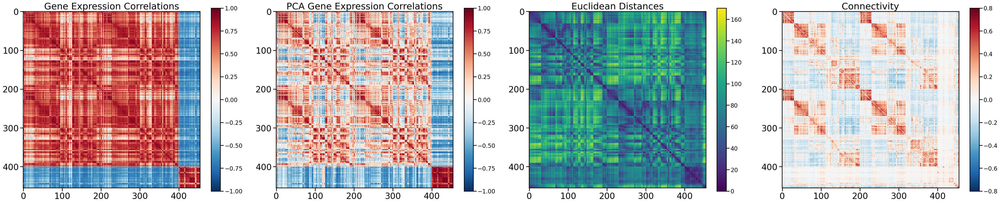

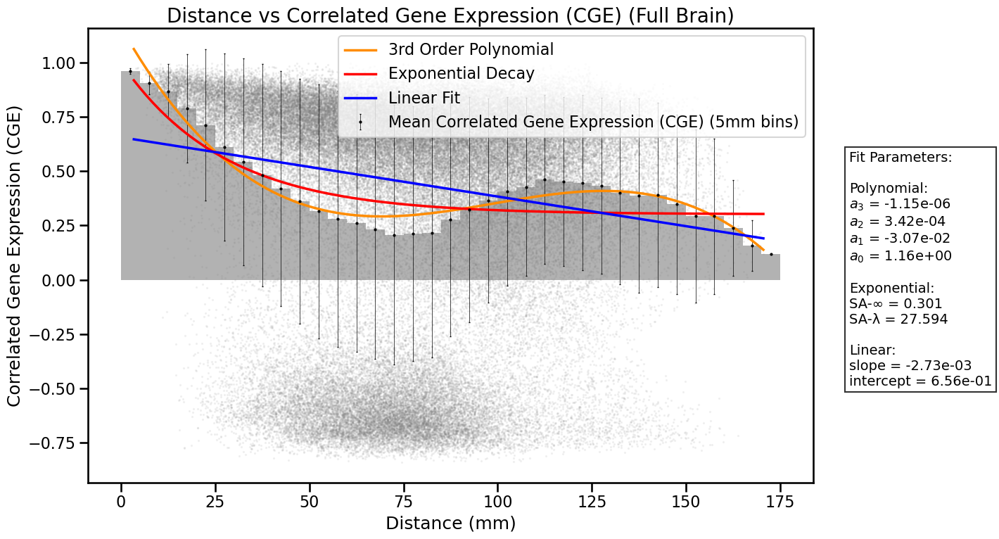

In [22]:
X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix = load_and_plot_data(parcellation='S400', hemisphere='both', omit_subcortical=False, 
                      sort_genes='expression', impute_strategy='mirror_interpolate', null_model='none', fontsize=26)

features, features_cortex, features_subcortex = subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix)

plot_distance_fits(features, 'CGE', 5, 'Full Brain')

Reload in raw data to be spun 

In [23]:
genes_data, valid_genes = load_transcriptome(parcellation='S400', 
                                             gene_list='0.2',
                                             run_PCA=False, 
                                             omit_subcortical=False, 
                                             hemisphere='both', 
                                             impute_strategy='mirror_interpolate', 
                                             sort_genes='expression', 
                                             return_valid_genes=True, null_model='none', random_seed=42)

genes_data_PCA = load_transcriptome(parcellation='S400', 
                                             gene_list='0.2',
                                             run_PCA=True, 
                                             omit_subcortical=False, 
                                             hemisphere='both', 
                                             impute_strategy='mirror_interpolate', 
                                             sort_genes='expression', 
                                             return_valid_genes=False, null_model='none', random_seed=42)

all_region_coords = load_coords(parcellation='S400', omit_subcortical=False)

num_cortical_regions = (genes_data.shape[0] // 100) * 100
cortical_genes_data = genes_data[:num_cortical_regions]
cortical_genes_data_PCA = genes_data_PCA[:num_cortical_regions]

subcortical_genes_data = genes_data[num_cortical_regions:]
subcortical_genes_data_PCA = genes_data_PCA[num_cortical_regions:]

subcortical_coords = all_region_coords[num_cortical_regions:]
x_coords = subcortical_coords[:, 0]
hemi_subcort = np.zeros_like(x_coords) # create mask for subcortical hemisphere
hemi_subcort[x_coords > 0] = 1
# drop cerebellum
hemi_subcort = hemi_subcort[:-10]


valid genes ['CRNDE', 'ECEL1', 'CHRNA3', 'RSPO4', 'TTR', 'RGS8', 'CA12', 'GINS3', 'KLHL13', 'S100PBP', 'PARD3B', 'PDE3A', 'SIX3', 'SCIN', 'NHSL1', 'BTN2A2', 'PIRT', 'RAB2B', 'SMIM30', 'DRD2', 'LONRF3', 'CYB5R3', 'SLITRK6', 'ELP4', 'HEYL', 'PKNOX1', 'GPRIN2', 'LHX8', 'MEGF11', 'C10orf105', 'AUTS2', 'PDIA3', 'PDIA3P1', 'CPNE3', 'TMEM255A', 'TMEM215', 'CYP7B1', 'IL13RA2', 'GPR75', 'TEAD1', 'KCNE5', 'PDLIM5', 'STAT1', 'C6orf118', 'CYLD', 'BAG3', 'TTPA', 'PINLYP', 'PCDH15', 'PREX2', 'PLXDC2', 'RASL12', 'DERL1', 'SCN7A', 'ARHGAP36', 'DNAJC12', 'AKIRIN2', 'ACVR1', 'ENKUR', 'NPL', 'FLVCR1', 'SAMD11', 'DNAH9', 'ADIPOR1', 'COL8A2', 'MAP3K1', 'LOC100233156', 'ADARB2-AS1', 'PFKFB3', 'SDC2', 'DAB2', 'CASC2', 'RGS22', 'PHKA1', 'HEY2', 'CENPVL3', 'PTGER3', 'CCDC85C', 'YBX3', 'PRSS35', 'VANGL1', 'PLXNA3', 'GLUD1', 'SSR1', 'MLF1', 'FAM210B', 'SERPINB1', 'WDR1', 'CFLAR', 'SZRD1', 'DAPL1', 'SPATA18', 'STK33', 'CFAP61', 'MAML2', 'DIRC2', 'ZNF516', 'MINK1', 'FAM111A', 'LINC01485', 'SCN9A', 'LINC00886', 'CX

Best mean rank spin

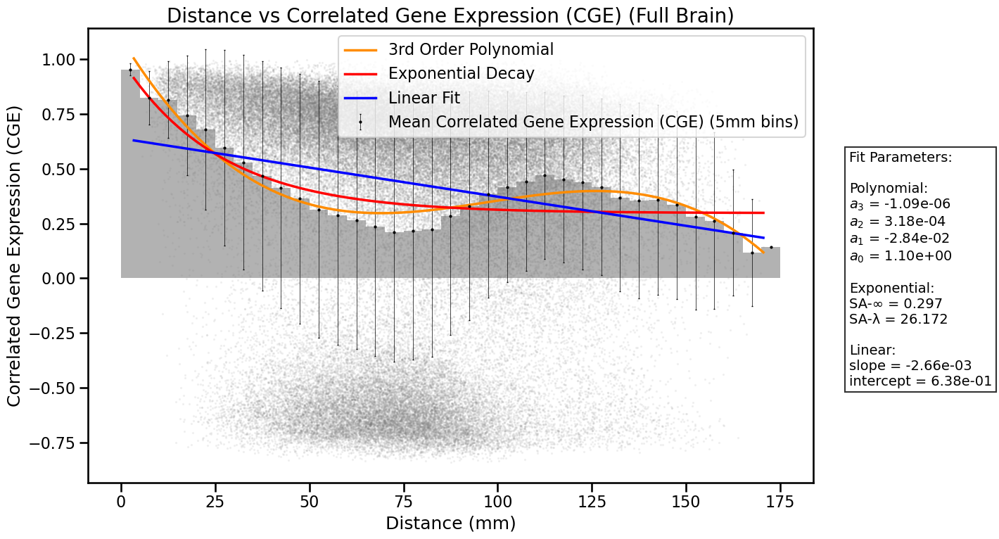

In [54]:
# Best spin
cortical_spin_indices_best = cortical_spin_indices[0, :]
subcortical_spin_indices_best = subcortical_spin_indices[0, :]

cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_best]
subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_spin_indices_best]
spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)
features = {'distances': dist_vec, 'CGE': CGE_vec}

plot_distance_fits(features, 'CGE', bin_size_mm=5)


Worst mean rank spin

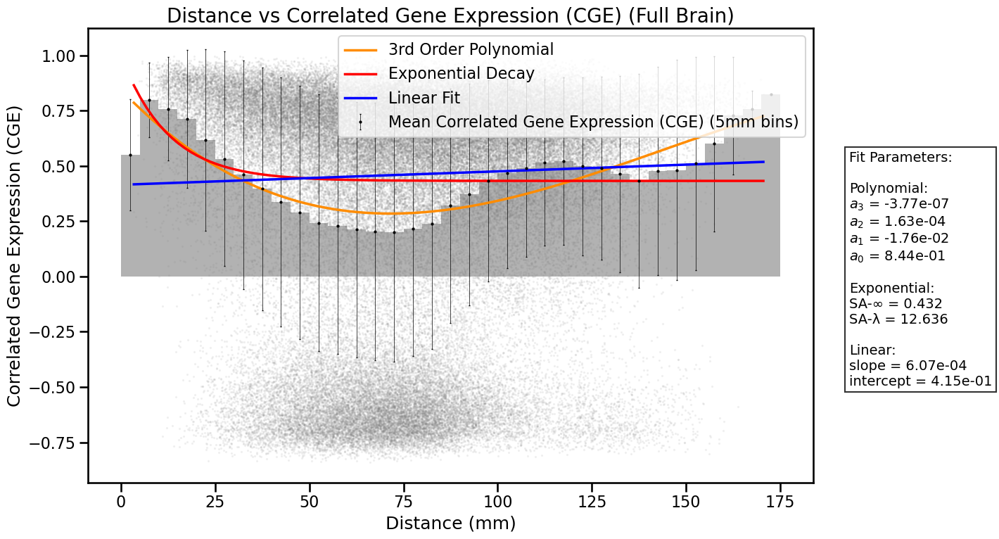

In [55]:
cortical_spin_indices_worst = cortical_spin_indices[-1, :]
subcortical_spin_indices_worst = subcortical_spin_indices[-1, :]

cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_worst]
subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_spin_indices_worst]
spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)
features = {'distances': dist_vec, 'CGE': CGE_vec}

plot_distance_fits(features, 'CGE', bin_size_mm=5)


Random spin retaining cortical, subcortical, cerebellar spatial layout

In [78]:
# Initialize empty lists to store spins
cortical_spins_list = []
subcortical_spins_list = []

# Iterate 1000 times with different random seeds
for seed in range(1000):
    np.random.seed(seed)
    cortical_spin_indices_random = cortical_spin_indices[seed, :]
    subcortical_spin_indices_random = subcortical_spin_indices[seed, :]

    # Spin hemispheres identically
    cortex_lh_rh_mapping = dict(zip(cortical_spin_indices_random[:200], cortical_spin_indices_random[200:]))

    # Generate permutation in one hemisphere then map to the other hemisphere
    lh_perm = np.random.permutation(np.arange(200))
    rh_perm = np.array([cortex_lh_rh_mapping[x] for x in lh_perm])
    cortical_spin_indices_hemi_random = np.concatenate([lh_perm, rh_perm])

    true_subcort_indices = np.arange(46)
    left_subcort_indices = true_subcort_indices[hemi_subcort == 0]
    right_subcort_indices = true_subcort_indices[hemi_subcort == 1]

    # Define a mapping between left and right subcortical indices
    subcort_lr_mapping = dict(zip(left_subcort_indices, right_subcort_indices))

    # Generate permutation in one hemisphere then map to the other hemisphere
    lh_subcort_perm = np.random.permutation(left_subcort_indices)
    rh_subcort_perm = np.array([subcort_lr_mapping[x] for x in lh_subcort_perm])
    subcortical_spin_indices_hemi_random = np.concatenate([lh_subcort_perm, rh_subcort_perm])

    # Permute cerebellum i.e. 46-56
    cerebellum_perm = np.random.permutation(np.arange(46, 56))
    subcortical_cerebellum_spin_indices_hemi_random = np.concatenate([subcortical_spin_indices_hemi_random, cerebellum_perm])

    # Append spins to lists
    cortical_spins_list.append(cortical_spin_indices_hemi_random.tolist())
    subcortical_spins_list.append(subcortical_cerebellum_spin_indices_hemi_random.tolist())

# Create dataframe
spatial_random_spins_df = pd.DataFrame({
    'cortical_spins': cortical_spins_list,
    'subcortical_spins': subcortical_spins_list
})

# Save spins to CSV
#spatial_random_spins_df.to_csv('./data/enigma/1000_spatial_random_spins.csv', index=False)

In [79]:
spatial_random_spins_df = pd.read_csv('./data/enigma/1000_spatial_random_spins.csv')

(1000, 400)
(1000, 56)


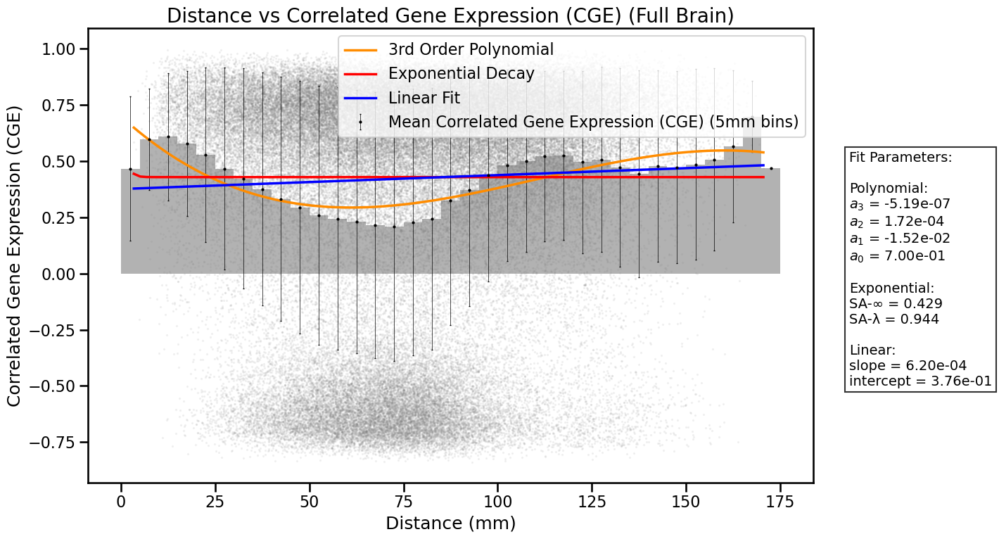

In [89]:
# Get list of indices to use for each null spin
cortical_spins_list = spatial_random_spins_df['cortical_spins'].apply(ast.literal_eval).values
cortical_spin_indices_hemi_random = np.vstack(cortical_spins_list)
print(cortical_spin_indices_hemi_random.shape)

subcortical_spins_list = spatial_random_spins_df['subcortical_spins'].apply(ast.literal_eval).values
subcortical_cerebellum_spin_indices_hemi_random = np.vstack(subcortical_spins_list)
print(subcortical_cerebellum_spin_indices_hemi_random.shape)

seed = 200
cortical_spin_indices_hemi_random = cortical_spin_indices_hemi_random[seed, :]
subcortical_cerebellum_spin_indices_hemi_random = subcortical_cerebellum_spin_indices_hemi_random[seed, :]

cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_hemi_random]
subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_cerebellum_spin_indices_hemi_random]
spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)
features = {'distances': dist_vec, 'CGE': CGE_vec}

plot_distance_fits(features, 'CGE', bin_size_mm=5)


True random

In [37]:
# Initialize empty lists to store spins
true_random_spins_list = []

# Iterate 1000 times with different random seeds
for seed in range(1000):
    np.random.seed(seed)
    # Generate completely random permutation of all indices
    spin_indices_random = np.random.permutation(np.arange(456))
    true_random_spins_list.append(spin_indices_random.tolist())

# Create dataframe
true_random_spins_df = pd.DataFrame({
    'true_random_spins': true_random_spins_list
})

#true_random_spins_df
# true_random_spins_df.to_csv('./data/enigma/1000_true_random_spins.csv', index=False)
true_random_spins_df = pd.read_csv('./data/enigma/1000_true_random_spins.csv')

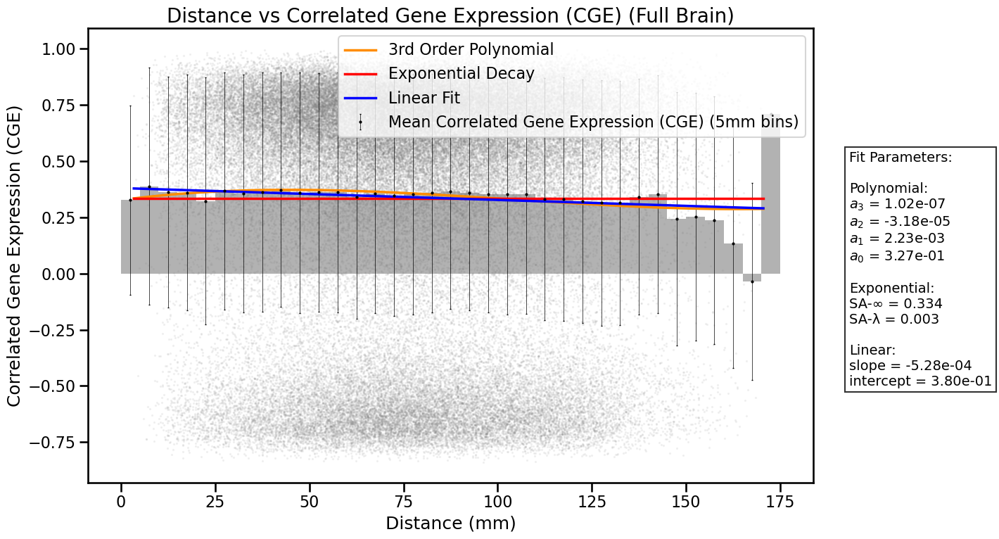

In [38]:
random_seed = 42
spin_indices_random = np.array(true_random_spins_df['true_random_spins'].apply(ast.literal_eval).values[random_seed])
spun_genes_data = genes_data[spin_indices_random]
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)
features = {'distances': dist_vec, 'CGE': CGE_vec}

plot_distance_fits(features, 'CGE', bin_size_mm=5)
